In [1]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [14]:
# Root directory for dataset
dataroot = "../../Workspace/webtoon/yumisepo/images/"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 48

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 500

# Learning rate for optimizers
lr = 0.00002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

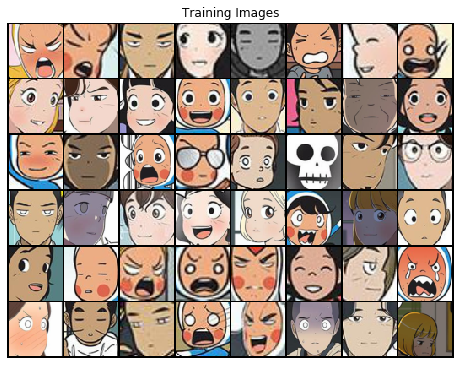

In [15]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [16]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [17]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [18]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [19]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [20]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [21]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [22]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/500][0/33]	Loss_D: 1.9995	Loss_G: 0.6155	D(x): 0.7073	D(G(z)): 0.7444 / 0.5884
[1/500][0/33]	Loss_D: 0.5183	Loss_G: 1.9642	D(x): 0.8549	D(G(z)): 0.2697 / 0.1837
[2/500][0/33]	Loss_D: 0.3525	Loss_G: 2.4667	D(x): 0.8690	D(G(z)): 0.1645 / 0.1087
[3/500][0/33]	Loss_D: 0.3030	Loss_G: 2.7139	D(x): 0.9086	D(G(z)): 0.1534 / 0.0891
[4/500][0/33]	Loss_D: 0.2054	Loss_G: 3.3419	D(x): 0.9302	D(G(z)): 0.0969 / 0.0508
[5/500][0/33]	Loss_D: 0.1948	Loss_G: 3.2696	D(x): 0.9302	D(G(z)): 0.1003 / 0.0507
[6/500][0/33]	Loss_D: 0.1906	Loss_G: 3.4236	D(x): 0.9422	D(G(z)): 0.1097 / 0.0461
[7/500][0/33]	Loss_D: 0.1174	Loss_G: 3.9644	D(x): 0.9457	D(G(z)): 0.0469 / 0.0251
[8/500][0/33]	Loss_D: 0.1017	Loss_G: 4.3048	D(x): 0.9568	D(G(z)): 0.0498 / 0.0220
[9/500][0/33]	Loss_D: 0.0970	Loss_G: 4.2063	D(x): 0.9579	D(G(z)): 0.0484 / 0.0200
[10/500][0/33]	Loss_D: 0.0809	Loss_G: 4.3257	D(x): 0.9622	D(G(z)): 0.0383 / 0.0162
[11/500][0/33]	Loss_D: 0.0594	Loss_G: 4.6934	D(x): 0.9743	D(G(z)): 0.03

[99/500][0/33]	Loss_D: 0.0016	Loss_G: 7.1041	D(x): 0.9989	D(G(z)): 0.0005 / 0.0010
[100/500][0/33]	Loss_D: 0.0138	Loss_G: 5.7198	D(x): 0.9911	D(G(z)): 0.0045 / 0.0042
[101/500][0/33]	Loss_D: 0.0160	Loss_G: 6.4614	D(x): 0.9991	D(G(z)): 0.0148 / 0.0024
[102/500][0/33]	Loss_D: 0.0064	Loss_G: 6.1304	D(x): 0.9989	D(G(z)): 0.0053 / 0.0030
[103/500][0/33]	Loss_D: 0.0218	Loss_G: 6.5763	D(x): 0.9817	D(G(z)): 0.0026 / 0.0030
[104/500][0/33]	Loss_D: 0.0357	Loss_G: 4.8804	D(x): 0.9709	D(G(z)): 0.0021 / 0.0112
[105/500][0/33]	Loss_D: 0.0105	Loss_G: 7.3575	D(x): 0.9917	D(G(z)): 0.0020 / 0.0008
[106/500][0/33]	Loss_D: 0.0106	Loss_G: 6.5660	D(x): 0.9930	D(G(z)): 0.0034 / 0.0026
[107/500][0/33]	Loss_D: 0.0062	Loss_G: 6.6380	D(x): 0.9990	D(G(z)): 0.0051 / 0.0027
[108/500][0/33]	Loss_D: 0.0094	Loss_G: 6.1900	D(x): 0.9969	D(G(z)): 0.0062 / 0.0034
[109/500][0/33]	Loss_D: 0.0136	Loss_G: 6.1813	D(x): 0.9938	D(G(z)): 0.0072 / 0.0038
[110/500][0/33]	Loss_D: 0.0086	Loss_G: 6.0051	D(x): 0.9986	D(G(z)): 0.0071 / 

[197/500][0/33]	Loss_D: 0.0216	Loss_G: 10.9201	D(x): 0.9800	D(G(z)): 0.0001 / 0.0003
[198/500][0/33]	Loss_D: 0.0283	Loss_G: 5.5560	D(x): 0.9985	D(G(z)): 0.0255 / 0.0122
[199/500][0/33]	Loss_D: 0.0139	Loss_G: 5.8607	D(x): 0.9942	D(G(z)): 0.0079 / 0.0040
[200/500][0/33]	Loss_D: 0.0285	Loss_G: 5.5023	D(x): 0.9805	D(G(z)): 0.0070 / 0.0066
[201/500][0/33]	Loss_D: 0.0548	Loss_G: 5.0834	D(x): 0.9998	D(G(z)): 0.0518 / 0.0090
[202/500][0/33]	Loss_D: 0.0231	Loss_G: 5.6491	D(x): 0.9990	D(G(z)): 0.0215 / 0.0063
[203/500][0/33]	Loss_D: 0.0273	Loss_G: 5.4889	D(x): 0.9873	D(G(z)): 0.0129 / 0.0075
[204/500][0/33]	Loss_D: 0.0237	Loss_G: 5.3698	D(x): 0.9849	D(G(z)): 0.0079 / 0.0080
[205/500][0/33]	Loss_D: 0.0251	Loss_G: 5.1712	D(x): 0.9981	D(G(z)): 0.0227 / 0.0091
[206/500][0/33]	Loss_D: 0.0170	Loss_G: 6.2279	D(x): 0.9866	D(G(z)): 0.0027 / 0.0035
[207/500][0/33]	Loss_D: 0.0059	Loss_G: 7.7457	D(x): 0.9999	D(G(z)): 0.0056 / 0.0020
[208/500][0/33]	Loss_D: 0.0240	Loss_G: 6.4712	D(x): 0.9802	D(G(z)): 0.0027 

[295/500][0/33]	Loss_D: 0.0049	Loss_G: 7.8935	D(x): 0.9970	D(G(z)): 0.0019 / 0.0014
[296/500][0/33]	Loss_D: 0.0212	Loss_G: 6.7834	D(x): 0.9990	D(G(z)): 0.0194 / 0.0034
[297/500][0/33]	Loss_D: 0.0189	Loss_G: 6.2751	D(x): 0.9935	D(G(z)): 0.0118 / 0.0044
[298/500][0/33]	Loss_D: 0.0177	Loss_G: 6.9961	D(x): 0.9850	D(G(z)): 0.0020 / 0.0020
[299/500][0/33]	Loss_D: 0.0126	Loss_G: 5.6120	D(x): 0.9957	D(G(z)): 0.0081 / 0.0070
[300/500][0/33]	Loss_D: 0.0100	Loss_G: 6.3011	D(x): 0.9977	D(G(z)): 0.0075 / 0.0042
[301/500][0/33]	Loss_D: 0.0018	Loss_G: 9.4542	D(x): 0.9996	D(G(z)): 0.0013 / 0.0003
[302/500][0/33]	Loss_D: 0.0115	Loss_G: 6.6659	D(x): 0.9986	D(G(z)): 0.0096 / 0.0036
[303/500][0/33]	Loss_D: 0.0409	Loss_G: 7.3011	D(x): 0.9974	D(G(z)): 0.0326 / 0.0015
[304/500][0/33]	Loss_D: 0.0060	Loss_G: 6.3664	D(x): 0.9992	D(G(z)): 0.0052 / 0.0030
[305/500][0/33]	Loss_D: 0.0270	Loss_G: 5.7093	D(x): 0.9929	D(G(z)): 0.0190 / 0.0064
[306/500][0/33]	Loss_D: 0.0331	Loss_G: 6.7707	D(x): 0.9960	D(G(z)): 0.0279 /

[393/500][0/33]	Loss_D: 0.0222	Loss_G: 6.1830	D(x): 0.9939	D(G(z)): 0.0155 / 0.0045
[394/500][0/33]	Loss_D: 0.0173	Loss_G: 6.4442	D(x): 0.9996	D(G(z)): 0.0164 / 0.0049
[395/500][0/33]	Loss_D: 0.0055	Loss_G: 7.0519	D(x): 0.9962	D(G(z)): 0.0016 / 0.0016
[396/500][0/33]	Loss_D: 0.0077	Loss_G: 7.3446	D(x): 0.9958	D(G(z)): 0.0033 / 0.0024
[397/500][0/33]	Loss_D: 0.0185	Loss_G: 6.5161	D(x): 0.9858	D(G(z)): 0.0031 / 0.0042
[398/500][0/33]	Loss_D: 0.0074	Loss_G: 7.0085	D(x): 0.9963	D(G(z)): 0.0037 / 0.0020
[399/500][0/33]	Loss_D: 0.0119	Loss_G: 6.7421	D(x): 0.9940	D(G(z)): 0.0058 / 0.0032
[400/500][0/33]	Loss_D: 0.0167	Loss_G: 6.2237	D(x): 0.9942	D(G(z)): 0.0105 / 0.0048
[401/500][0/33]	Loss_D: 0.0052	Loss_G: 8.9642	D(x): 0.9953	D(G(z)): 0.0005 / 0.0003
[402/500][0/33]	Loss_D: 0.0239	Loss_G: 4.9741	D(x): 0.9998	D(G(z)): 0.0224 / 0.0203
[403/500][0/33]	Loss_D: 0.0124	Loss_G: 5.6756	D(x): 0.9987	D(G(z)): 0.0105 / 0.0065
[404/500][0/33]	Loss_D: 0.0313	Loss_G: 5.4918	D(x): 0.9844	D(G(z)): 0.0141 /

[491/500][0/33]	Loss_D: 0.0039	Loss_G: 9.6479	D(x): 0.9992	D(G(z)): 0.0031 / 0.0004
[492/500][0/33]	Loss_D: 0.0036	Loss_G: 7.8917	D(x): 0.9978	D(G(z)): 0.0014 / 0.0009
[493/500][0/33]	Loss_D: 0.0105	Loss_G: 7.5120	D(x): 0.9915	D(G(z)): 0.0012 / 0.0017
[494/500][0/33]	Loss_D: 0.0020	Loss_G: 6.9177	D(x): 0.9994	D(G(z)): 0.0013 / 0.0025
[495/500][0/33]	Loss_D: 0.5638	Loss_G: 18.4606	D(x): 0.9994	D(G(z)): 0.2388 / 0.0000
[496/500][0/33]	Loss_D: 0.0502	Loss_G: 11.2327	D(x): 0.9645	D(G(z)): 0.0001 / 0.0001
[497/500][0/33]	Loss_D: 0.0072	Loss_G: 7.6486	D(x): 0.9954	D(G(z)): 0.0025 / 0.0016
[498/500][0/33]	Loss_D: 0.0065	Loss_G: 7.4242	D(x): 0.9971	D(G(z)): 0.0034 / 0.0018
[499/500][0/33]	Loss_D: 0.0030	Loss_G: 7.4944	D(x): 0.9990	D(G(z)): 0.0020 / 0.0010


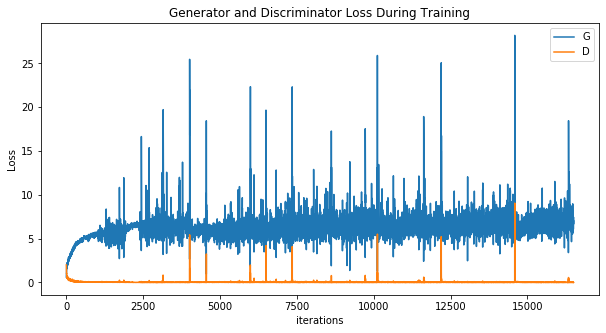

In [24]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21542998 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


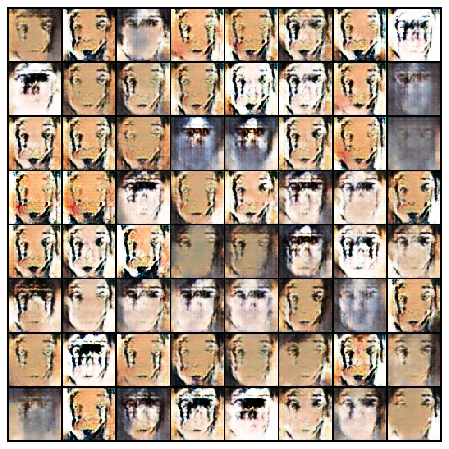

In [41]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

writergif = animation.PillowWriter(fps=10) 
ani.save('yumisepo_training.gif', writer=writergif)

HTML(ani.to_jshtml())

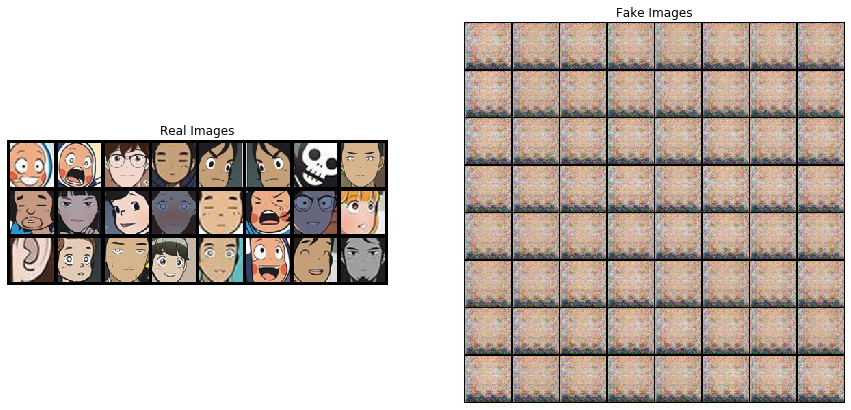

In [13]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()